### Задание №1

Белобородова Анна

----------------------------------

In [1]:
import numpy as np
from PIL import Image
from numba import njit, prange

In [2]:
original = Image.open("Original.bmp")
reference = Image.open("RGB_CFA.bmp")

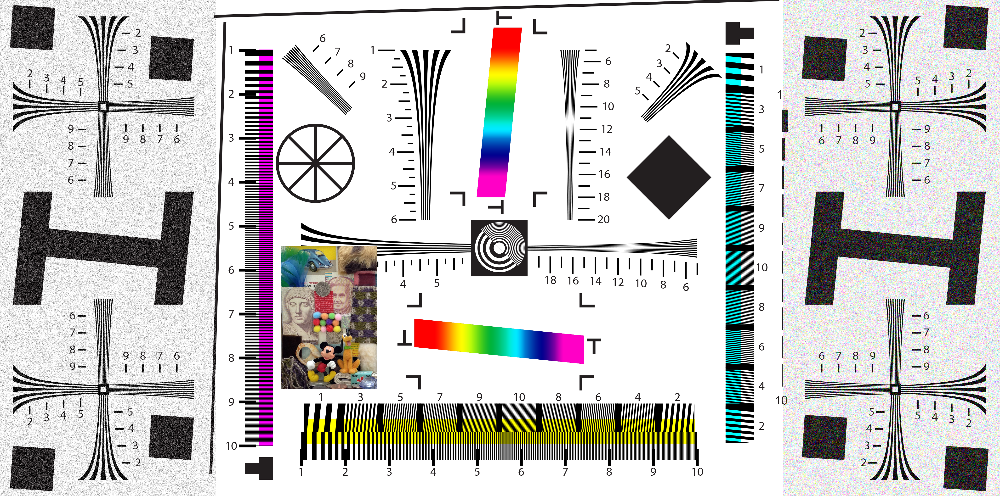

In [3]:
original

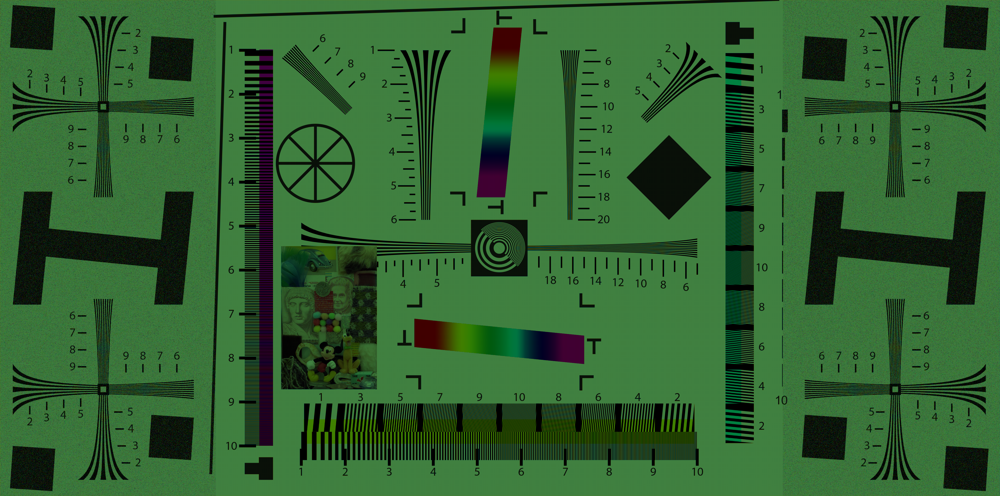

In [4]:
reference

In [5]:
reference = np.asarray(reference, dtype=np.int64)
original = np.asarray(original, dtype=np.int64)

Посчитаем количество пикселей

In [6]:
reference.shape[0] * reference.shape[1]

8656848

Напишем все необходимые функции. Разделим алгоритм на три этапа (как в лекции). 

Первый этап (функция get_green_value) - получение компоненты G в местах, где определены R или B.

In [7]:
@njit
def get_green_value(green_image, red_blue_image, x_coord, y_coord):
    x_size, y_size = green_image.shape
    red_blue_pixel = red_blue_image[y_coord, x_coord]
    
    N = 2 * abs(red_blue_pixel  - red_blue_image[y_coord - 2, x_coord]) + \
            abs(green_image[y_coord + 1, x_coord] - green_image[y_coord - 1, x_coord])
            
    E = 2 * abs(red_blue_pixel - red_blue_image[y_coord, x_coord + 2]) + \
            abs(green_image[y_coord, x_coord + 1] - green_image[y_coord, x_coord - 1])
            
    W = 2 * abs(red_blue_pixel - red_blue_image[y_coord, x_coord - 2]) + \
            abs(green_image[y_coord, x_coord + 1] - green_image[y_coord, x_coord - 1])
            
    S = 2 * abs(red_blue_pixel - red_blue_image[y_coord + 2, x_coord]) + \
            abs(green_image[y_coord + 1, x_coord] - green_image[y_coord - 1, x_coord])
    
    min_value = min(N, E, W, S)
    
    if N == min_value:
        green_value = (green_image[y_coord - 1, x_coord] * 3 + green_image[y_coord + 1, x_coord] + \
                       red_blue_pixel  - red_blue_image[y_coord - 2, x_coord]) / 4
    elif E == min_value:
        green_value = (green_image[y_coord, x_coord + 1] * 3 + green_image[y_coord, x_coord - 1] + \
                       red_blue_pixel - red_blue_image[y_coord, x_coord + 2]) / 4
    elif W == min_value:
        green_value = (green_image[y_coord, x_coord - 1] * 3 + green_image[y_coord, x_coord + 1] + \
                       red_blue_pixel - red_blue_image[y_coord, x_coord - 2]) / 4
    elif S == min_value:
        green_value = (green_image[y_coord + 1, x_coord] * 3 + green_image[y_coord - 1, x_coord]  + \
                       red_blue_pixel - red_blue_image[y_coord + 2, x_coord]) / 4
        
    return min(max(green_value, 0), 255)

Для следующих двух этапов нам понадобится функция hue_transit.

In [8]:
@njit
def hue_transit(L1, L2, L3, V1, V3):
    if L1 < L2 and L2 < L3 or L1 > L2 and L2 > L3:
        return V1 + (V3 - V1) * (L2 - L1) / (L3 - L1)
    return (V1 + V3) / 2 + (L2 - (L1 + L3) / 2) / 2

Второй этап (функция get_red_and_blue_value) - получение компонент B и R для пикселей, где они обе не определены по уже найденным зеленым.

In [9]:
@njit
def get_red_and_blue_value(green_image, red_image, blue_image, x_coord, y_coord):
    if y_coord % 2 != 0:
        blue_value = hue_transit(green_image[y_coord, x_coord - 1],
                                 green_image[y_coord, x_coord], 
                                 green_image[y_coord, x_coord + 1],
                                 blue_image[y_coord, x_coord - 1],
                                 blue_image[y_coord, x_coord + 1])
        
        red_value = hue_transit(green_image[y_coord - 1, x_coord], 
                                green_image[y_coord, x_coord], 
                                green_image[y_coord + 1, x_coord],
                                red_image[y_coord - 1, x_coord],
                                red_image[y_coord + 1, x_coord])
                                 
    else:
        blue_value = hue_transit(green_image[y_coord - 1, x_coord], 
                                 green_image[y_coord, x_coord], 
                                 green_image[y_coord + 1, x_coord],
                                 blue_image[y_coord - 1, x_coord],
                                 blue_image[y_coord + 1, x_coord])
        
        red_value = hue_transit(green_image[y_coord, x_coord - 1], 
                                green_image[y_coord, x_coord], 
                                green_image[y_coord, x_coord + 1],
                                red_image[y_coord, x_coord - 1],
                                red_image[y_coord, x_coord + 1])

    return min(max(red_value, 0), 255), min(max(blue_value, 0), 255)

Третий этап (функция get_red_or_blue_value) - получение компоненты B для пикселей, имевших компоненту R, и наоборот.

In [10]:
@njit
def get_red_or_blue_value(green_image, red_blue_image, x_coord, y_coord):    
    NE = abs(red_blue_image[y_coord - 1, x_coord + 1] - red_blue_image[y_coord + 1, x_coord - 1]) + \
         abs(red_blue_image[y_coord - 2, x_coord + 2] - red_blue_image[y_coord, x_coord]) + \
         abs(red_blue_image[y_coord, x_coord] - red_blue_image[y_coord + 2, x_coord - 2]) + \
         abs(green_image[y_coord - 1, x_coord + 1] - green_image[y_coord, x_coord]) + \
         abs(green_image[y_coord, x_coord] - green_image[y_coord + 1, x_coord - 1])
    
    NW = abs(red_blue_image[y_coord - 1, x_coord - 1] - red_blue_image[y_coord + 1, x_coord + 1]) + \
         abs(red_blue_image[y_coord - 2, x_coord - 2] - red_blue_image[y_coord, x_coord]) + \
         abs(red_blue_image[y_coord, x_coord] - red_blue_image[y_coord + 2, x_coord + 2]) + \
         abs(green_image[y_coord - 1, x_coord - 1] - green_image[y_coord, x_coord]) + \
         abs(green_image[y_coord, x_coord] - green_image[y_coord + 1, x_coord + 1])
    
    if NE < NW:
        value = hue_transit(green_image[y_coord - 1, x_coord + 1], 
                            green_image[y_coord, x_coord],
                            green_image[y_coord + 1, x_coord - 1],
                            red_blue_image[y_coord - 1, x_coord + 1],
                            red_blue_image[y_coord + 1, x_coord - 1])
                            
        return min(max(value, 0), 255)
    
    value = hue_transit(green_image[y_coord - 1, x_coord - 1], 
                        green_image[y_coord, x_coord],
                        green_image[y_coord + 1, x_coord + 1],
                        red_blue_image[y_coord - 1, x_coord - 1],
                        red_blue_image[y_coord + 1, x_coord + 1])
    
    return min(max(value, 0), 255)

Итак, теперь итоговая функция:

In [11]:
@njit
def PPG(pad_image):
    red_image = pad_image[:, :, 0].copy()
    green_image = pad_image[:, :, 1].copy()
    blue_image = pad_image[:, :, 2].copy()
    red_blue_image = red_image + blue_image
    
    # Первый этап
    for y_coord in prange(2, pad_image.shape[0] - 2):
        for x_coord in prange(2, pad_image.shape[1] - 2):
            if (x_coord + y_coord) % 2 == 0:
                green_image[y_coord, x_coord] = get_green_value(green_image, red_blue_image, x_coord, y_coord)

    # Второй этап
    for y_coord in prange(2, pad_image.shape[0] - 2):
        for x_coord in prange(2, pad_image.shape[1] - 2):
            if (x_coord + y_coord) % 2 != 0:
                red_image[y_coord, x_coord], blue_image[y_coord, x_coord] = \
                                                get_red_and_blue_value(green_image, red_image, blue_image, x_coord, y_coord)

    # Третий этап    
    for y_coord in prange(2, pad_image.shape[0] - 2):
        for x_coord in prange(2, pad_image.shape[1] - 2):
            if x_coord % 2 == 0 and y_coord % 2 == 0:
                blue_image[y_coord, x_coord] = get_red_or_blue_value(green_image, red_blue_image, x_coord, y_coord)
            if x_coord % 2 != 0 and y_coord % 2 != 0:
                red_image[y_coord, x_coord] = get_red_or_blue_value(green_image, red_blue_image, x_coord, y_coord) 
                
        
    target_image = np.zeros((pad_image.shape[0] - 4, pad_image.shape[1] - 4, pad_image.shape[2]))
    for y_coord in prange(2, pad_image.shape[0] - 2):
        for x_coord in prange(2, pad_image.shape[1] - 2):
            target_image[y_coord - 2, x_coord - 2, 0] = red_image[y_coord, x_coord]
            target_image[y_coord - 2, x_coord - 2, 1] = green_image[y_coord, x_coord]
            target_image[y_coord - 2, x_coord - 2, 2] = blue_image[y_coord, x_coord]
    
    return target_image

In [12]:
%%time

# Сделаем паддинг, чтобы работать с краевыми случаями 
npad = ((2, 2), (2, 2), (0, 0))
res_image = PPG(np.pad(reference, npad))

Wall time: 2.6 s


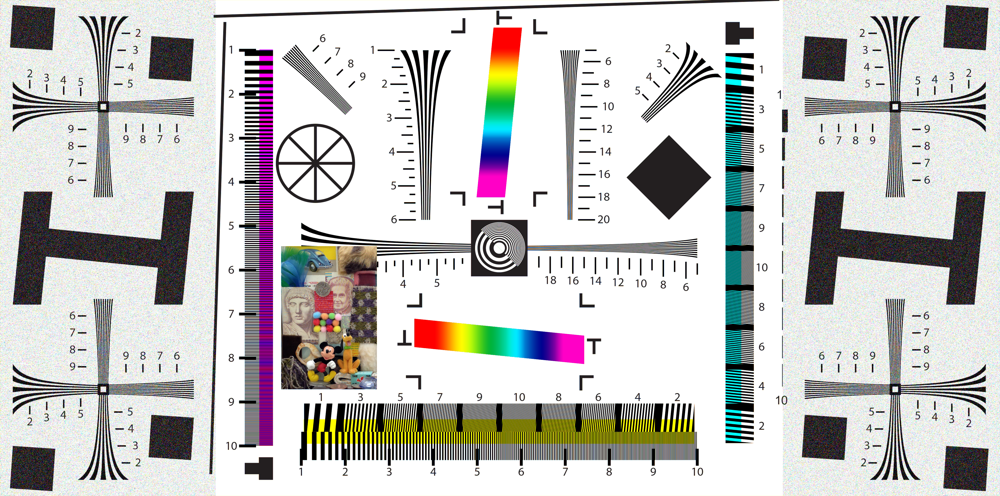

In [13]:
pil_image = Image.fromarray(res_image.astype(np.uint8))
pil_image.save("result.bmp")
pil_image

In [14]:
def get_PSNR(original, res_image): 
    cfa_original = 0.299 * original[:, :, 0] + 0.587 * original[:, :, 1] + 0.114 * original[:, :, 2]
    cfa_res_image = 0.299 * res_image[:, :, 0] + 0.587 * res_image[:, :, 1] + 0.114 * res_image[:, :, 2]
    mse = np.mean((cfa_original - cfa_res_image) ** 2)
    y_max = 255.0
    psnr = 10 * np.log10(y_max ** 2 / mse) 
    return psnr

In [15]:
get_PSNR(original, res_image)

25.176288669592545

## Итоги

Итоговая метрика PSNR: 25.176

Разрешение изображения снижается примерно в 1.33 раза - с 16 у оригинального изображения до 12 у полученного в результате работы алгоритма.

Скорость выполнения программы: $2.6$ сек / $(8656848 * 10^{-6})$  мегапикселей $\approx$  $0,3$ сек/мегапиксель